In [3]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from sklearn.metrics import classification_report, roc_auc_score, roc_curve
import matplotlib.pyplot as plt
import gdown
import plotly.express as px
import plotly.graph_objects as go
from tensorflow.keras import backend as K
from sklearn.cluster import KMeans
from pathlib import Path
import matplotlib.pyplot as plt

##Download do Dataset

In [4]:
## https://drive.google.com/file/d/1YJN5_u2I4fuMuymWAZK1wTo4xLUPvY-E/view?usp=sharing

In [5]:
df_train_transaction_fraudes = "1YJN5_u2I4fuMuymWAZK1wTo4xLUPvY-E"
url_fraudes = f"https://drive.google.com/uc?id={df_train_transaction_fraudes}"
gdown.download(url_fraudes, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?id=1YJN5_u2I4fuMuymWAZK1wTo4xLUPvY-E
From (redirected): https://drive.google.com/uc?id=1YJN5_u2I4fuMuymWAZK1wTo4xLUPvY-E&confirm=t&uuid=02c622fa-4d37-469e-b4ff-8db8398e3ac6
To: /content/train_transaction.csv
100%|██████████| 683M/683M [00:05<00:00, 114MB/s]


'train_transaction.csv'

In [6]:
df_train_transaction = pd.read_csv("train_transaction.csv")

## Análise Exploratória

In [7]:
df_train_transaction.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2987002,0,86469,59.0,W,4663,490.0,150.0,visa,166.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2987003,0,86499,50.0,W,18132,567.0,150.0,mastercard,117.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2987004,0,86506,50.0,H,4497,514.0,150.0,mastercard,102.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [8]:
df_train_transaction['M6'].unique()

array(['T', 'F', nan], dtype=object)

In [9]:
df_train_transaction.columns.values

array(['TransactionID', 'isFraud', 'TransactionDT', 'TransactionAmt',
       'ProductCD', 'card1', 'card2', 'card3', 'card4', 'card5', 'card6',
       'addr1', 'addr2', 'dist1', 'dist2', 'P_emaildomain',
       'R_emaildomain', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8',
       'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'D1', 'D2', 'D3', 'D4',
       'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14',
       'D15', 'M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9', 'V1',
       'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11',
       'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29',
       'V30', 'V31', 'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38',
       'V39', 'V40', 'V41', 'V42', 'V43', 'V44', 'V45', 'V46', 'V47',
       'V48', 'V49', 'V50', 'V51', 'V52', 'V53', 'V54', 'V55', 'V56',
       'V57', 'V58', 'V59', 'V60', 'V61', 'V62', 'V63', 'V64', 'V65',
       'V66', 'V6

In [10]:
df_train_transaction.shape

(590540, 394)

In [11]:
df_train_transaction.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 590540 entries, 0 to 590539
Columns: 394 entries, TransactionID to V339
dtypes: float64(376), int64(4), object(14)
memory usage: 1.7+ GB


In [12]:
for column in df_train_transaction.columns:
    print(f"Column: {column}, Data type: {df_train_transaction[column].dtype}")

Column: TransactionID, Data type: int64
Column: isFraud, Data type: int64
Column: TransactionDT, Data type: int64
Column: TransactionAmt, Data type: float64
Column: ProductCD, Data type: object
Column: card1, Data type: int64
Column: card2, Data type: float64
Column: card3, Data type: float64
Column: card4, Data type: object
Column: card5, Data type: float64
Column: card6, Data type: object
Column: addr1, Data type: float64
Column: addr2, Data type: float64
Column: dist1, Data type: float64
Column: dist2, Data type: float64
Column: P_emaildomain, Data type: object
Column: R_emaildomain, Data type: object
Column: C1, Data type: float64
Column: C2, Data type: float64
Column: C3, Data type: float64
Column: C4, Data type: float64
Column: C5, Data type: float64
Column: C6, Data type: float64
Column: C7, Data type: float64
Column: C8, Data type: float64
Column: C9, Data type: float64
Column: C10, Data type: float64
Column: C11, Data type: float64
Column: C12, Data type: float64
Column: C13, 

In [13]:
df_train_transaction.describe()

,TransactionID,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
count,5.905400e+05,590540.000000,5.905400e+05,590540.000000,590540.000000,581607.000000,588975.000000,586281.000000,524834.000000,524834.000000,...,82351.000000,82351.000000,82351.000000,82351.000000,82351.000000,82351.00000,82351.000000,82351.000000,82351.000000,82351.000000
mean,3.282270e+06,0.034990,7.372311e+06,135.027176,9898.734658,362.555488,153.194925,199.278897,290.733794,86.800630,...,0.775874,721.741883,1375.783644,1014.622782,9.807015,59.16455,28.530903,55.352422,151.160542,100.700882
std,1.704744e+05,0.183755,4.617224e+06,239.162522,4901.170153,157.793246,11.336444,41.244453,101.741072,2.690623,...,4.727971,6217.223583,11169.275702,7955.735482,243.861391,387.62948,274.576920,668.486833,1095.034387,814.946722
min,2.987000e+06,0.000000,8.640000e+04,0.251000,1000.000000,100.000000,100.000000,100.000000,100.000000,10.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
25%,3.134635e+06,0.000000,3.027058e+06,43.321000,6019.000000,214.000000,150.000000,166.000000,204.000000,87.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
50%,3.282270e+06,0.000000,7.306528e+06,68.769000,9678.000000,361.000000,150.000000,226.000000,299.000000,87.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
75%,3.429904e+06,0.000000,1.124662e+07,125.000000,14184.000000,512.000000,150.000000,226.000000,330.000000,87.000000,...,0.000000,0.000000,25.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
max,3.577539e+06,1.000000,1.581113e+07,31937.391000,18396.000000,600.000000,231.000000,237.000000,540.000000,102.000000,...,55.000000,160000.000000,160000.000000,160000.000000,55125.000000,55125.00000,55125.000000,104060.000000,104060.000000,104060.000000


In [14]:
df_train_transaction.isnull().sum()

,0
TransactionID,0
isFraud,0
TransactionDT,0
TransactionAmt,0
ProductCD,0
...,...
V335,508189
V336,508189
V337,508189
V338,508189


In [15]:
null_values = df_train_transaction.isna().sum()

In [16]:
fig = px.histogram(df_train_transaction, x = 'TransactionAmt')
fig.show()

Identificando outliers e atribuindo sua visualização gráfica

In [17]:
df_numerico = df_train_transaction.select_dtypes(exclude = 'object').columns
df_numerico = df_train_transaction[['TransactionAmt', 'card1', 'card2', 'card3', 'card5']]

In [18]:
for i in df_numerico:
    fig = px.box(df_train_transaction, y=i)
    fig.show()

In [19]:
df_train_transaction

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,2987000,0,86400,68.50,W,13926,NaN,150.0,discover,142.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.00,W,2755,404.0,150.0,mastercard,102.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2987002,0,86469,59.00,W,4663,490.0,150.0,visa,166.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2987003,0,86499,50.00,W,18132,567.0,150.0,mastercard,117.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2987004,0,86506,50.00,H,4497,514.0,150.0,mastercard,102.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
590535,3577535,0,15811047,49.00,W,6550,NaN,150.0,visa,226.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
590536,3577536,0,15811049,39.50,W,10444,225.0,150.0,mastercard,224.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
590537,3577537,0,15811079,30.95,W,12037,595.0,150.0,mastercard,224.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
590538,3577538,0,15811088,117.00,W,7826,481.0,150.0,mastercard,224.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [20]:
df_num_corr = df_train_transaction.drop(['ProductCD', 'card4', 'card6', 'addr1', 'addr2', 'dist1', 'dist2', 'P_emaildomain', 'R_emaildomain', 'M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9'], axis=1)
df_num_corr.corr()

,TransactionID,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,C1,C2,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
TransactionID,1.000000,0.014166,0.998280,0.012025,0.010122,-0.019900,-0.010091,-0.023900,-0.053154,-0.055186,...,0.250831,0.199285,0.219190,0.223816,0.005893,0.179740,0.103030,0.074034,0.203922,0.162702
isFraud,0.014166,1.000000,0.013103,0.011320,-0.013640,0.003388,0.154151,-0.033580,0.030570,0.037229,...,-0.021164,-0.021982,-0.023468,-0.024134,-0.000451,-0.005456,-0.002402,-0.005702,-0.019356,-0.014663
TransactionDT,0.998280,0.013103,1.000000,0.011920,0.010625,-0.019202,-0.011222,-0.024132,-0.049318,-0.051126,...,0.258603,0.205671,0.226312,0.231072,0.005762,0.184407,0.105783,0.075892,0.210240,0.167524
TransactionAmt,0.012025,0.011320,0.011920,1.000000,-0.005725,0.016136,-0.109785,0.003061,-0.017722,-0.018468,...,0.003909,0.024319,0.010808,0.017385,0.078751,0.044830,0.070651,0.129452,0.082064,0.105996
card1,0.010122,-0.013640,0.010625,-0.005725,1.000000,0.004960,0.002965,-0.093633,0.005716,0.005199,...,0.146483,0.121763,0.133150,0.136557,-0.001903,0.080603,0.050555,0.036052,0.118885,0.091271
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V335,0.179740,-0.005456,0.184407,0.044830,0.080603,0.044073,0.000465,-0.209817,-0.000626,-0.001999,...,0.647561,0.593782,0.647208,0.657350,0.703988,1.000000,0.914130,0.166021,0.552533,0.411911
V336,0.103030,-0.002402,0.105783,0.070651,0.050555,0.029899,-0.001279,-0.139576,0.005776,0.004829,...,0.412448,0.389508,0.410970,0.425812,0.906312,0.914130,1.000000,0.118221,0.353950,0.274392
V337,0.074034,-0.005702,0.075892,0.129452,0.036052,0.017705,0.001361,-0.076374,0.004203,0.003600,...,0.245626,0.309989,0.259108,0.295698,0.041888,0.166021,0.118221,1.000000,0.742652,0.907378
V338,0.203922,-0.019356,0.210240,0.082064,0.118885,0.055566,0.001970,-0.233342,-0.001844,-0.003692,...,0.780555,0.752075,0.800310,0.823754,0.054911,0.552533,0.353950,0.742652,1.000000,0.940009


## Normalização e Tratamento dos dados

In [21]:
df_train_transaction = pd.get_dummies(df_train_transaction, columns=['card4', 'card6', 'ProductCD'], dtype='int')

In [22]:
df_train_transaction

,TransactionID,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,...,card4_visa,card6_charge card,card6_credit,card6_debit,card6_debit or credit,ProductCD_C,ProductCD_H,ProductCD_R,ProductCD_S,ProductCD_W
0,2987000,0,86400,68.50,13926,NaN,150.0,142.0,315.0,87.0,...,0,0,1,0,0,0,0,0,0,1
1,2987001,0,86401,29.00,2755,404.0,150.0,102.0,325.0,87.0,...,0,0,1,0,0,0,0,0,0,1
2,2987002,0,86469,59.00,4663,490.0,150.0,166.0,330.0,87.0,...,1,0,0,1,0,0,0,0,0,1
3,2987003,0,86499,50.00,18132,567.0,150.0,117.0,476.0,87.0,...,0,0,0,1,0,0,0,0,0,1
4,2987004,0,86506,50.00,4497,514.0,150.0,102.0,420.0,87.0,...,0,0,1,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
590535,3577535,0,15811047,49.00,6550,NaN,150.0,226.0,272.0,87.0,...,1,0,0,1,0,0,0,0,0,1
590536,3577536,0,15811049,39.50,10444,225.0,150.0,224.0,204.0,87.0,...,0,0,0,1,0,0,0,0,0,1
590537,3577537,0,15811079,30.95,12037,595.0,150.0,224.0,231.0,87.0,...,0,0,0,1,0,0,0,0,0,1
590538,3577538,0,15811088,117.00,7826,481.0,150.0,224.0,387.0,87.0,...,0,0,0,1,0,0,0,0,0,1


In [23]:
df_num_corr.fillna(0, inplace=True)

In [24]:
df_train_transaction.fillna(0, inplace=True)

In [25]:
df_num_corr

,TransactionID,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,C1,C2,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,2987000,0,86400,68.50,13926,0.0,150.0,142.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2987001,0,86401,29.00,2755,404.0,150.0,102.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2987002,0,86469,59.00,4663,490.0,150.0,166.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2987003,0,86499,50.00,18132,567.0,150.0,117.0,2.0,5.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2987004,0,86506,50.00,4497,514.0,150.0,102.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
590535,3577535,0,15811047,49.00,6550,0.0,150.0,226.0,2.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
590536,3577536,0,15811049,39.50,10444,225.0,150.0,224.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
590537,3577537,0,15811079,30.95,12037,595.0,150.0,224.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
590538,3577538,0,15811088,117.00,7826,481.0,150.0,224.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [26]:
# fig = px.imshow(df_num_corr)
# fig.show()

In [27]:
df_train_transaction = df_train_transaction.drop(['addr1', 'addr2', 'dist1', 'dist2', 'P_emaildomain', 'R_emaildomain', 'M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9'], axis=1)

In [28]:
scaler = RobustScaler()

df_train_transaction[['TransactionAmt']] = scaler.fit_transform(df_train_transaction[['TransactionAmt']])
df_train_transaction[['card1']] = scaler.fit_transform(df_train_transaction[['card1']])
df_train_transaction[['card2']] = scaler.fit_transform(df_train_transaction[['card2']])
df_train_transaction[['card3']] = scaler.fit_transform(df_train_transaction[['card3']])
df_train_transaction[['card5']] = scaler.fit_transform(df_train_transaction[['card5']])

In [29]:
df_train_transaction

,TransactionID,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,C1,C2,...,card4_visa,card6_charge card,card6_credit,card6_debit,card6_debit or credit,ProductCD_C,ProductCD_H,ProductCD_R,ProductCD_S,ProductCD_W
0,2987000,0,86400,-0.003293,0.520269,-1.168831,0.0,-1.400000,1.0,1.0,...,0,0,1,0,0,0,0,0,0,1
1,2987001,0,86401,-0.486894,-0.847887,0.142857,0.0,-2.066667,1.0,1.0,...,0,0,1,0,0,0,0,0,0,1
2,2987002,0,86469,-0.119602,-0.614207,0.422078,0.0,-1.000000,1.0,1.0,...,1,0,0,1,0,0,0,0,0,1
3,2987003,0,86499,-0.229790,1.035395,0.672078,0.0,-1.816667,2.0,5.0,...,0,0,0,1,0,0,0,0,0,1
4,2987004,0,86506,-0.229790,-0.634538,0.500000,0.0,-2.066667,1.0,1.0,...,0,0,1,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
590535,3577535,0,15811047,-0.242033,-0.383099,-1.168831,0.0,0.000000,2.0,1.0,...,1,0,0,1,0,0,0,0,0,1
590536,3577536,0,15811049,-0.358342,0.093815,-0.438312,0.0,-0.033333,1.0,1.0,...,0,0,0,1,0,0,0,0,0,1
590537,3577537,0,15811079,-0.463020,0.288916,0.762987,0.0,-0.033333,1.0,1.0,...,0,0,0,1,0,0,0,0,0,1
590538,3577538,0,15811088,0.590494,-0.226822,0.392857,0.0,-0.033333,1.0,1.0,...,0,0,0,1,0,0,0,0,0,1


### LSTM

In [34]:
df_train_transaction.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 590540 entries, 0 to 590539
Columns: 389 entries, TransactionID to ProductCD_W
dtypes: float64(373), int64(16)
memory usage: 1.7 GB


In [35]:
def balanciar(df):
    rus = RandomUnderSampler(random_state=42)
    X = df.drop('isFraud', axis=1).values
    y = df[['isFraud']].values.flatten()  # Flatten to make it a 1D array

    X_res, y_res = rus.fit_resample(X, y)

    # Convert the resampled arrays back to DataFrame
    df_resampled = pd.DataFrame(X_res, columns=df.columns[:-1])  # Use original feature names
    df_resampled['isFraud'] = y_res  # Add the target variable

    return df_resampled

df_train_transaction = balanciar(df_train_transaction)

In [36]:
X = df_train_transaction.drop('isFraud', axis=1).values
y = df_train_transaction[['isFraud']].values

In [37]:
X.shape

(41326, 387)

In [38]:
y.shape

(41326, 1)

In [39]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, roc_auc_score, roc_curve
import matplotlib.pyplot as plt
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping

# Divisão dos dados em treinamento e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Redimensionando os dados para a LSTM (amostras, passos no tempo, features)
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

model = Sequential()

# Camada LSTM com Dropout para evitar overfitting
model.add(LSTM(100, input_shape=(X_train.shape[1], 1), return_sequences=True))
model.add(Dropout(0.2))

model.add(LSTM(50, return_sequences=True))
model.add(Dropout(0.2))

model.add(LSTM(20, return_sequences=False))
model.add(Dropout(0.2))

model.add(Dense(1, activation='sigmoid'))

# Compilação do modelo com otimizador Adam
model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['accuracy', 'recall', 'precision'])

# Treinamento com EarlyStopping para evitar overfitting
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history = model.fit(X_train, y_train, epochs=15, batch_size=720, validation_data=(X_test, y_test), callbacks=[early_stop], verbose=1)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/15
46/46 ━━━━━━━━━━━━━━━━━━━━ 13s 161ms/step - accuracy: 0.5782 - loss: 0.6709 - precision: 0.5899 - recall: 0.5308 - val_accuracy: 0.7127 - val_loss: 0.5822 - val_precision: 0.7564 - val_recall: 0.6287
Epoch 2/15
46/46 ━━━━━━━━━━━━━━━━━━━━ 7s 150ms/step - accuracy: 0.7047 - loss: 0.5795 - precision: 0.7227 - recall: 0.6605 - val_accuracy: 0.7037 - val_loss: 0.5721 - val_precision: 0.7466 - val_recall: 0.6180
Epoch 3/15
46/46 ━━━━━━━━━━━━━━━━━━━━ 7s 152ms/step - accuracy: 0.6994 - loss: 0.5730 - precision: 0.7244 - recall: 0.6464 - val_accuracy: 0.7263 - val_loss: 0.5532 - val_precision: 0.7374 - val_recall: 0.7043
Epoch 4/15
46/46 ━━━━━━━━━━━━━━━━━━━━ 7s 152ms/step - accuracy: 0.7119 - loss: 0.5571 - precision: 0.7241 - recall: 0.6832 - val_accuracy: 0.7309 - val_loss: 0.5471 - val_precision: 0.7883 - val_recall: 0.6325
Epoch 5/15
46/46 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - accuracy: 0.7178 - loss: 0.5519 - precision: 0.7365 - recall: 0.6739 - val_accuracy: 0.7309 - val_loss: 0

259/259 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step
Classification Report:
               precision    recall  f1-score   support

           0       0.73      0.77      0.75      4127
           1       0.76      0.71      0.73      4139

    accuracy                           0.74      8266
   macro avg       0.74      0.74      0.74      8266
weighted avg       0.74      0.74      0.74      8266

Confusion Matrix:
 [[3192  935]
 [1206 2933]]
259/259 ━━━━━━━━━━━━━━━━━━━━ 4s 14ms/step


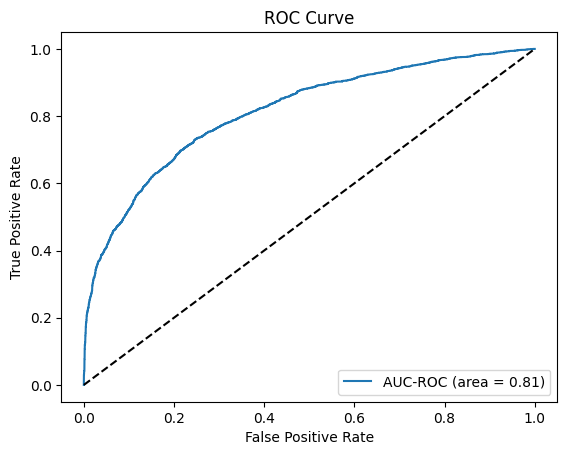

In [40]:
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve, auc

# Previsão no conjunto de teste
y_pred = (model.predict(X_test) > 0.5).astype("int32")

# Relatório de classificação
print("Classification Report:\n", classification_report(y_test, y_pred))

# Matriz de confusão
conf_matrix = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:\n", conf_matrix)

# Cálculo do AUC-ROC
y_pred_prob = model.predict(X_test).ravel()
roc_auc = roc_auc_score(y_test, y_pred_prob)

# Curva ROC
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
plt.figure()
plt.plot(fpr, tpr, label=f'AUC-ROC (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc="lower right")
plt.show()

In [41]:
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve, f1_score

y_pred = (model.predict(X_test) > 0.5).astype("int32")

# Cálculo do F1-Score
f1 = f1_score(y_test, y_pred)
print(f"F1-Score: {f1:.4f}")

# Relatório de classificação (inclui precisão, recall e F1-Score)
print("Classification Report:\n", classification_report(y_test, y_pred))

259/259 ━━━━━━━━━━━━━━━━━━━━ 4s 14ms/step
F1-Score: 0.7326
Classification Report:
               precision    recall  f1-score   support

           0       0.73      0.77      0.75      4127
           1       0.76      0.71      0.73      4139

    accuracy                           0.74      8266
   macro avg       0.74      0.74      0.74      8266
weighted avg       0.74      0.74      0.74      8266



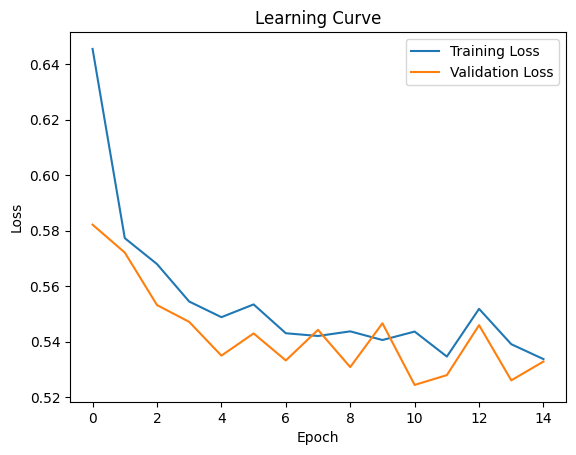

In [42]:
# Plotando a curva de aprendizado (loss de treinamento e validação)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Learning Curve')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()

Pelo fato da sobrescrição das linhas de treino e teste, é possível dizer que o modelo está com um pouco de overfit devido ao seu comportamento durante as épocas atribuídas.

In [43]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

259/259 ━━━━━━━━━━━━━━━━━━━━ 4s 14ms/step


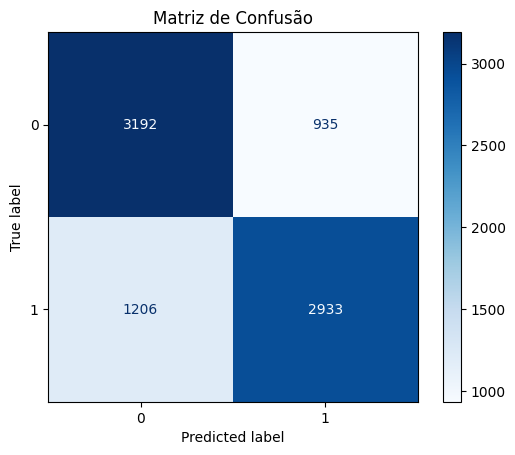

In [44]:
y_pred = model.predict(X_test)
y_pred = np.round(y_pred).astype(int)

cm = confusion_matrix(y_test, y_pred)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
disp.plot(cmap=plt.cm.Blues)
plt.title('Matriz de Confusão')
plt.show()

## Ajustes possíveis

Para os possíveis ajustes, poderíamos utilizar algumas ferramentas como Dropout ou Early Stopping para prevenir o overfit do modelo. Mesmo assim, talvez seja necessário também voltar as variáveis e verificar certinho cada uma das features, e identificar sua relevância de acordo com o que foi proposto


## *Outros itens que podem ser abordados*

### Regularização:

L1 e L2: Adicione penalizações aos pesos da rede. A regularização L2 (também conhecida como weight decay) é especialmente comum.
Dropout: Introduza camadas de dropout que desligam aleatoriamente uma fração dos neurônios durante o treinamento, forçando a rede a aprender representações mais robustas.

### Aumento de Dados:

Aumente o conjunto de dados com técnicas como rotação, translação, escalonamento ou inversão das imagens, se estiver lidando com dados visuais. Para dados tabulares, você pode introduzir ruído ou gerar amostras sintéticas.

### Batch Normalization:

Aplique normalização de lote, que pode ajudar a estabilizar e acelerar o treinamento, além de proporcionar alguma regularização.

### Ajuste de Hiperparâmetros:

Experimente diferentes taxas de aprendizado, tamanhos de lote e outros hiperparâmetros que podem impactar a generalização do modelo.

### Cross-Validation:

Use validação cruzada para avaliar o modelo em diferentes subconjuntos dos dados, ajudando a garantir que ele generalize bem.

### Transfer Learning:

Para problemas complexos, considere usar um modelo pré-treinado e ajustá-lo para seu problema específico, o que pode melhorar a generalização.